In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

from tensorflow.keras.layers import Dense,Flatten, Dropout
from tensorflow.keras.optimizers import Adam

Đọc dữ liệu từ file

In [2]:
import pathlib

data_dir = "data"
data_dir = pathlib.Path(data_dir)

count=0
array_flowers_length= []
array_flowers=[]
for item in data_dir.iterdir():
    length_item = len(list(item.glob('*')))
    name_item= str(item).replace("data\\","")                
    print(name_item + ": ", end="")
    print((length_item), end=" Flowers")
    print()
    array_flowers_length.append(count+ length_item)
    count+= length_item

image_count = len(list(data_dir.glob('*/*')))
print("Tổng số hoa: "+ str(image_count))


hoa_Anh_thao: 40 Flowers
hoa_Anh_tuc: 101 Flowers
hoa_Bim_bip: 204 Flowers
hoa_Bi_ngan: 91 Flowers
hoa_Bo_cau: 144 Flowers
hoa_Bo_cong_anh: 38 Flowers
hoa_Buom: 85 Flowers
hoa_Cam_chuong: 74 Flowers
hoa_Cam_tu_cau: 125 Flowers
hoa_Chi_van_mon: 201 Flowers
hoa_Cuc: 119 Flowers
hoa_Cuc_canh_moi: 60 Flowers
hoa_Cuc_gai_tim: 85 Flowers
hoa_Cuc_mat_bo: 236 Flowers
hoa_Dam_but: 319 Flowers
hoa_Dao: 102 Flowers
hoa_Da_quy: 143 Flowers
hoa_Dien_vi: 49 Flowers
hoa_Dua_can: 140 Flowers
hoa_Giay: 183 Flowers
hoa_Hong: 222 Flowers
hoa_Hong_but: 51 Flowers
hoa_Hong_mon: 202 Flowers
hoa_Hong_sa_mac: 62 Flowers
hoa_Hue_chuoi: 80 Flowers
hoa_Huong_duong: 192 Flowers
hoa_Ke_sua: 45 Flowers
hoa_Kim_cuong: 46 Flowers
hoa_Kim_lien: 41 Flowers
hoa_Lac_tien: 251 Flowers
hoa_Loa_ken_van: 38 Flowers
hoa_Ly: 178 Flowers
hoa_Ly_lua: 40 Flowers
hoa_Mac_co: 178 Flowers
hoa_Mai: 138 Flowers
hoa_Mao_luong: 71 Flowers
hoa_Moc_lan: 63 Flowers
hoa_Ngu_sac: 148 Flowers
hoa_Phong_lu: 114 Flowers
hoa_Quat_ba_tieu: 34 Flo

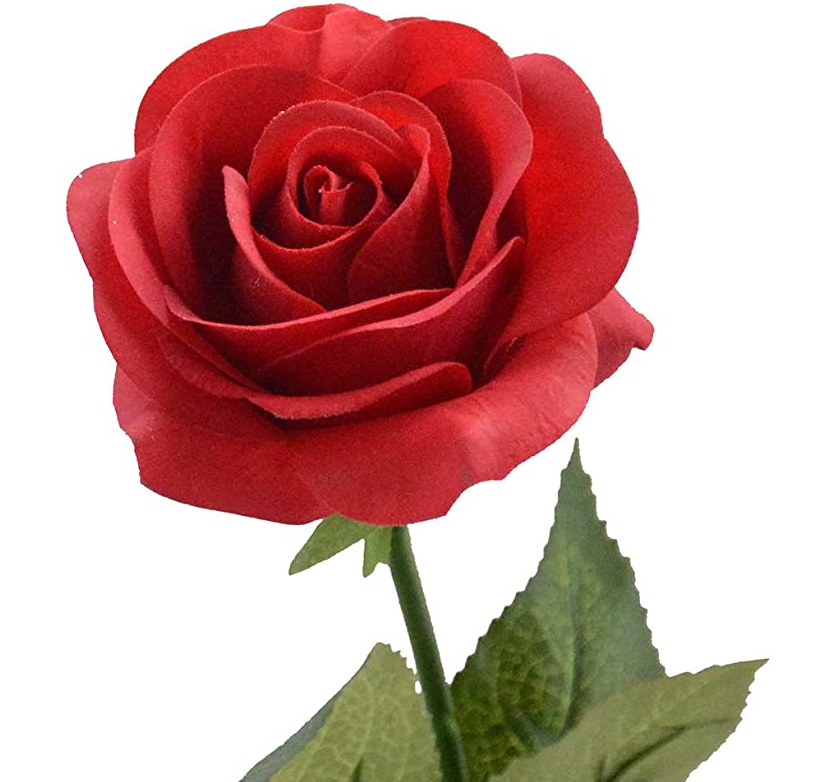

In [64]:
hong = list(data_dir.glob('hoa_Hong/*'))
PIL.Image.open(str(hong[1]))

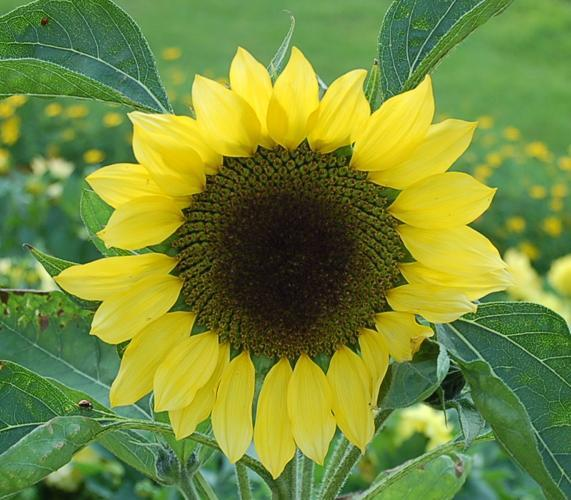

In [65]:
hoa_huong_duong = list(data_dir.glob('hoa_Huong_duong/*'))
PIL.Image.open(str(hoa_huong_duong[100]))

In [3]:
batch_size = 32
img_height = 256
img_width = 256

In [4]:
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="training",
  
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)


Found 6168 files belonging to 50 classes.
Using 4935 files for training.


In [5]:
val_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="validation",

  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)


Found 6168 files belonging to 50 classes.
Using 1233 files for validation.


In [6]:
class_names = train_ds.class_names

default_classnames= class_names

class_names=['Hoa Anh thảo','Hoa Anh túc','Hoa Bỉ ngạn', 'Hoa Bìm bịp', 'Hoa Bồ câu', 'Hoa Bồ công anh','Hoa Bướm', 'Hoa Cẩm chướng','hoa Cẩm tú cầu', 'Hoa Chi vân môn', 'Hoa Cúc','Hoa Cúc cánh mối', 'Hoa Cúc gai tím','Hoa Cúc mắt bò', 'Hoa Dã quỳ', 'Hoa Dâm bụt', 'Hoa Đào','Hoa Diên vĩ', 'Hoa Dừa cạn', 'Hoa Giấy', 'Hoa Hồng','Hoa Hồng bụt', 'Hoa Hồng môn', 'Hoa Hồng sa mạc','Hoa Huệ chuối', 'Hoa Hướng dương','Hoa Kế sữa','Hoa Kim cương','Hoa Kim Liên','Hoa Lạc tiên', 'Hoa Loa kèn vằn', 'Hoa Ly','Hoa Ly lửa', 'Hoa Mắc cỡ', 'Hoa Mai','Hoa Mao lương','Hoa Mộc lan', 'Hoa Ngũ Sắc','Hoa Phong lữ','Hoa Quạt ba tiêu', 'Hoa Riềng tía','Hoa Sen cạn', 'Hoa Sứ', 'Hoa Súng', 'Hoa Thiên điểu', 'Hoa Thược dược','Hoa Thuỷ tiên','Hoa Tiên khách lai', 'Hoa Trạng Nguyên', 'Hoa Vạn thọ']
print(class_names)

['Hoa Anh thảo', 'Hoa Anh túc', 'Hoa Bỉ ngạn', 'Hoa Bìm bịp', 'Hoa Bồ câu', 'Hoa Bồ công anh', 'Hoa Bướm', 'Hoa Cẩm chướng', 'hoa Cẩm tú cầu', 'Hoa Chi vân môn', 'Hoa Cúc', 'Hoa Cúc cánh mối', 'Hoa Cúc gai tím', 'Hoa Cúc mắt bò', 'Hoa Dã quỳ', 'Hoa Dâm bụt', 'Hoa Đào', 'Hoa Diên vĩ', 'Hoa Dừa cạn', 'Hoa Giấy', 'Hoa Hồng', 'Hoa Hồng bụt', 'Hoa Hồng môn', 'Hoa Hồng sa mạc', 'Hoa Huệ chuối', 'Hoa Hướng dương', 'Hoa Kế sữa', 'Hoa Kim cương', 'Hoa Kim Liên', 'Hoa Lạc tiên', 'Hoa Loa kèn vằn', 'Hoa Ly', 'Hoa Ly lửa', 'Hoa Mắc cỡ', 'Hoa Mai', 'Hoa Mao lương', 'Hoa Mộc lan', 'Hoa Ngũ Sắc', 'Hoa Phong lữ', 'Hoa Quạt ba tiêu', 'Hoa Riềng tía', 'Hoa Sen cạn', 'Hoa Sứ', 'Hoa Súng', 'Hoa Thiên điểu', 'Hoa Thược dược', 'Hoa Thuỷ tiên', 'Hoa Tiên khách lai', 'Hoa Trạng Nguyên', 'Hoa Vạn thọ']


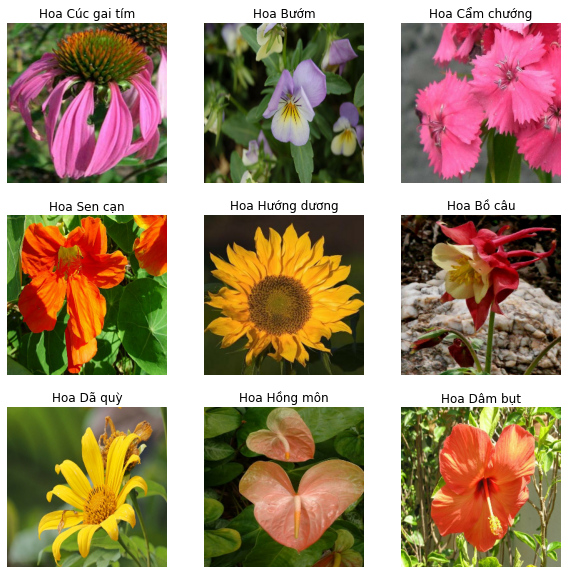

In [70]:
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

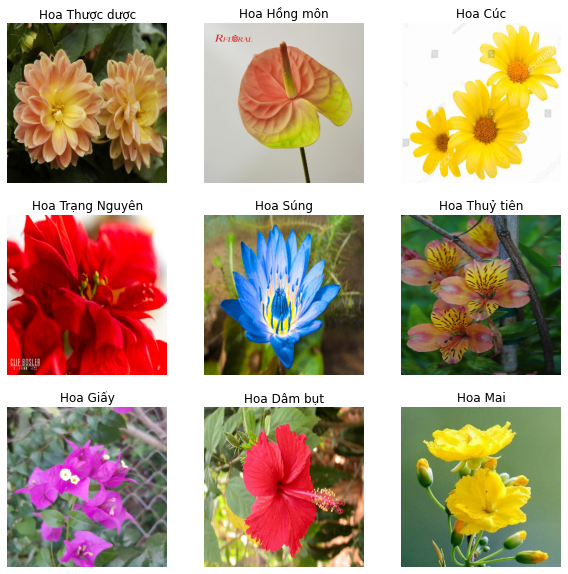

In [71]:
plt.figure(figsize=(10, 10))
for images, labels in val_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [72]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 256, 256, 3)
(32,)


In [73]:
AUTOTUNE = tf.data.AUTOTUNE
train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

In [74]:
normalization_layer = layers.experimental.preprocessing.Rescaling(1./255)

In [75]:
normalized_ds = train_ds.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_ds))
first_image = image_batch[0]
# Notice the pixels values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image)) 

0.0 1.0


In [76]:
num_classes = len(class_names)

model = Sequential([
  layers.experimental.preprocessing.Rescaling(1./255, input_shape=(img_height, img_width, 3)),
  layers.Conv2D(filters = 16, kernel_size = (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D(pool_size=(2,2)),
  layers.Conv2D(filters = 32, kernel_size = (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D(pool_size=(2,2)),
  layers.Conv2D(filters = 64, kernel_size = (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D(pool_size=(2,2)),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes,  activation='softmax')
])

print(num_classes)

50


In [77]:
# PIL.Image.open("demo_img/dense.png")
# PIL.Image.open("demo_img/pooling.png")
# PIL.Image.open("demo_img/model.png")

In [78]:
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [79]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_7 (Rescaling)     (None, 256, 256, 3)       0         
                                                                 
 conv2d_9 (Conv2D)           (None, 256, 256, 16)      448       
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 128, 128, 16)     0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 128, 128, 32)      4640      
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 64, 64, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_11 (Conv2D)          (None, 64, 64, 64)       

In [80]:
epochs = 15
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/15
155/155 [==============================] - 150s 968ms/step - loss: 2.8754 - accuracy: 0.2575 - val_loss: 2.2507 - val_accuracy: 0.3852
Epoch 2/15
155/155 [==============================] - 144s 932ms/step - loss: 1.7221 - accuracy: 0.5179 - val_loss: 1.7766 - val_accuracy: 0.4955
Epoch 3/15
155/155 [==============================] - 143s 922ms/step - loss: 0.8529 - accuracy: 0.7544 - val_loss: 1.7348 - val_accuracy: 0.5401
Epoch 4/15
155/155 [==============================] - 143s 930ms/step - loss: 0.2670 - accuracy: 0.9273 - val_loss: 2.0611 - val_accuracy: 0.5312
Epoch 5/15
155/155 [==============================] - 143s 926ms/step - loss: 0.1197 - accuracy: 0.9672 - val_loss: 2.4268 - val_accuracy: 0.5231
Epoch 6/15
155/155 [==============================] - 145s 933ms/step - loss: 0.0686 - accuracy: 0.9803 - val_loss: 2.6563 - val_accuracy: 0.5093
Epoch 7/15
155/155 [==============================] - 145s 934ms/step - loss: 0.0284 - accuracy: 0.9941 - val_loss: 2.9664 -

In [81]:
model.save('model.h5')

In [82]:
def visualize_result(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']

    loss = history.history['loss']
    val_loss = history.history['val_loss']

    epochs_range = range(epochs)

    plt.figure(figsize=(8, 8))
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, acc, label='Training Accuracy')
    plt.plot(epochs_range, val_acc, label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.title('Training and Validation Accuracy')

    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, loss, label='Training Loss')
    plt.plot(epochs_range, val_loss, label='Validation Loss')
    plt.legend(loc='upper right')
    plt.title('Training and Validation Loss')
    plt.show()

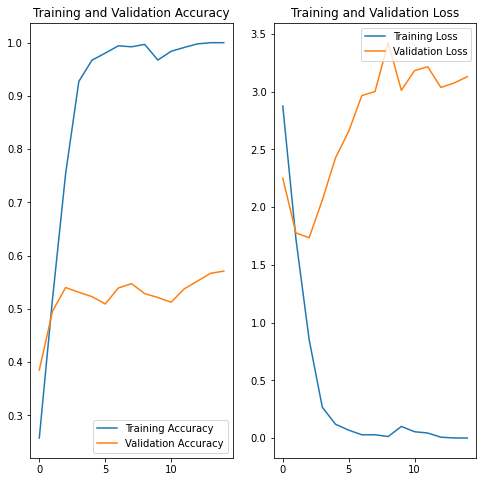

In [83]:
visualize_result(history)

In [84]:
data_augmentation = keras.Sequential(
  [
    layers.experimental.preprocessing.RandomFlip("horizontal", 
                                                 input_shape=(img_height, 
                                                              img_width,
                                                              3)),
    layers.experimental.preprocessing.RandomRotation(0.1),
    layers.experimental.preprocessing.RandomZoom(0.1)
  ]
)

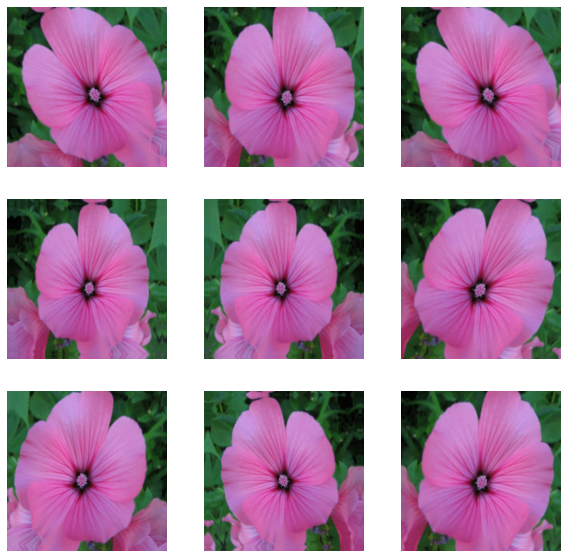

In [85]:
plt.figure(figsize=(10, 10))
for images, _ in train_ds.take(1):
  for i in range(9):
    augmented_images = data_augmentation(images)
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(augmented_images[0].numpy().astype("uint8"))
    plt.axis("off")

In [86]:
model_aug = keras.Sequential([
  data_augmentation,
    
  layers.experimental.preprocessing.Rescaling(1./255, input_shape=(img_height, img_width, 3)),
  layers.Conv2D(filters = 16, kernel_size = (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D(pool_size=(2,2)),
  layers.Conv2D(filters = 32, kernel_size = (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D(pool_size=(2,2)),
  layers.Conv2D(filters = 64, kernel_size = (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D(pool_size=(2,2)),
    
  layers.Dropout(0.2),
    
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes, activation='softmax')
])

In [87]:
model_aug.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [88]:
epochs = 15
history = model_aug.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/15
155/155 [==============================] - 171s 1s/step - loss: 3.1380 - accuracy: 0.1868 - val_loss: 2.4851 - val_accuracy: 0.3171
Epoch 2/15
155/155 [==============================] - 169s 1s/step - loss: 2.2299 - accuracy: 0.3696 - val_loss: 2.0127 - val_accuracy: 0.4234
Epoch 3/15
155/155 [==============================] - 169s 1s/step - loss: 1.8829 - accuracy: 0.4705 - val_loss: 1.7840 - val_accuracy: 0.4891
Epoch 4/15
155/155 [==============================] - 168s 1s/step - loss: 1.6362 - accuracy: 0.5273 - val_loss: 1.8413 - val_accuracy: 0.4826
Epoch 5/15
155/155 [==============================] - 169s 1s/step - loss: 1.4512 - accuracy: 0.5828 - val_loss: 1.5630 - val_accuracy: 0.5629
Epoch 6/15
155/155 [==============================] - 167s 1s/step - loss: 1.3090 - accuracy: 0.6176 - val_loss: 1.4608 - val_accuracy: 0.5742
Epoch 7/15
155/155 [==============================] - 168s 1s/step - loss: 1.1822 - accuracy: 0.6517 - val_loss: 1.5352 - val_accuracy: 0.5637

In [89]:
model_aug.save('model_aug.h5')

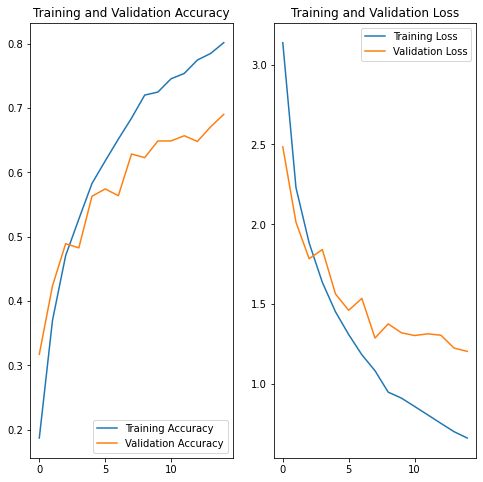

In [90]:
visualize_result(history)

In [91]:
resnet_model = Sequential()

pretrained_model= tf.keras.applications.ResNet50(include_top=False,
                   input_shape=(img_height,img_width,3),
                   pooling='avg',classes= num_classes,
                   weights='imagenet')
for layer in pretrained_model.layers:
        layer.trainable=False
resnet_model.add(data_augmentation)
resnet_model.add(pretrained_model)
resnet_model.add(Dropout(0.2))
resnet_model.add(Flatten())
resnet_model.add(Dense(512, activation='relu'))
resnet_model.add(Dense(num_classes, activation='softmax'))

In [92]:
resnet_model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_4 (Sequential)   (None, 256, 256, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 2048)              23587712  
                                                                 
 dropout_1 (Dropout)         (None, 2048)              0         
                                                                 
 flatten_5 (Flatten)         (None, 2048)              0         
                                                                 
 dense_10 (Dense)            (None, 512)               1049088   
                                                                 
 dense_11 (Dense)            (None, 50)                25650     
                                                                 
Total params: 24,662,450
Trainable params: 1,074,738
N

In [93]:
resnet_model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [94]:
epochs = 10
history = resnet_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/10
155/155 [==============================] - 611s 4s/step - loss: 1.0717 - accuracy: 0.7230 - val_loss: 0.4693 - val_accuracy: 0.8589
Epoch 2/10
155/155 [==============================] - 616s 4s/step - loss: 0.3483 - accuracy: 0.8916 - val_loss: 0.3370 - val_accuracy: 0.9059
Epoch 3/10
155/155 [==============================] - 618s 4s/step - loss: 0.2183 - accuracy: 0.9331 - val_loss: 0.4265 - val_accuracy: 0.8816
Epoch 4/10
155/155 [==============================] - 616s 4s/step - loss: 0.1917 - accuracy: 0.9394 - val_loss: 0.3551 - val_accuracy: 0.9075
Epoch 5/10
155/155 [==============================] - 614s 4s/step - loss: 0.1428 - accuracy: 0.9583 - val_loss: 0.3930 - val_accuracy: 0.9051
Epoch 6/10
155/155 [==============================] - 612s 4s/step - loss: 0.1114 - accuracy: 0.9658 - val_loss: 0.2849 - val_accuracy: 0.9221
Epoch 7/10
155/155 [==============================] - 629s 4s/step - loss: 0.0974 - accuracy: 0.9684 - val_loss: 0.3568 - val_accuracy: 0.9140

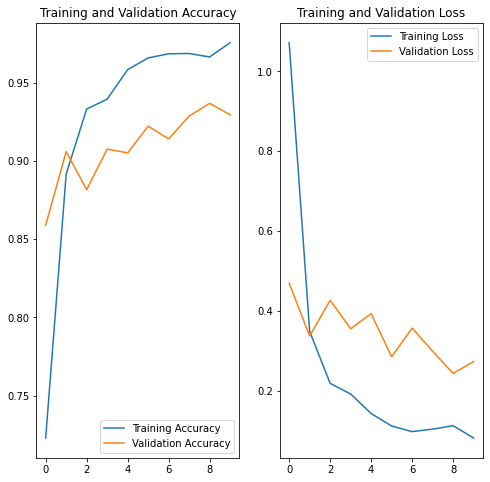

In [95]:
visualize_result(history)

In [96]:
resnet_model.save('resnet_model.h5')

c:\machinelearning\lib\site-packages\keras\engine\functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


In [7]:
model= tf.keras.models.load_model('model.h5')
model_aug= tf.keras.models.load_model('model_aug.h5')
resnet_model= tf.keras.models.load_model('resnet_model.h5')

In [8]:
import glob 
import matplotlib.image as mpimg
import cv2
import re

def evaluate_model(model_input):
    def  predict_lots_img(img):
        predict_img= img
    
        image=cv2.imread(str(predict_img))[...,::-1]
        image_resized= cv2.resize(image, (256, 256))
        image=np.expand_dims(image_resized,axis=0)
        pred=model_input.predict(image)
        output_class= default_classnames[np.argmax(pred)]
    
        return output_class

    images = []
    path=[]
  
    for img_path in glob.glob('test_24/*'):
        images.append(mpimg.imread(img_path))
        path.append(img_path)
    
    plt.figure(figsize=(25, 25))
    count=0
    
    for i, image in enumerate(images):
    
        predict_class= predict_lots_img(path[i])
        path_class = path[i].replace("test_24\\","")
        path_class = path_class.replace(".jpg","")
        path_class= re.sub("\(\d\)","", path_class)

        if predict_class== path_class:
            count+=1
        
        plt.subplot(6, 4, i+1)
        plt.imshow(image)
        
        plt.title("Model Predicted: " + predict_class +"\n" + "True Class: " + path_class )
        plt.axis("off")
    print("Accuracy= " + str(count/ len(images)*100) + "%")
    print( "Số hoa đoán đúng: "+ str(count) + ", Số hoa đoán sai: "+ str(len(images) -count) )
    


Accuracy= 78.26086956521739%
Số hoa đoán đúng: 18, Số hoa đoán sai: 5


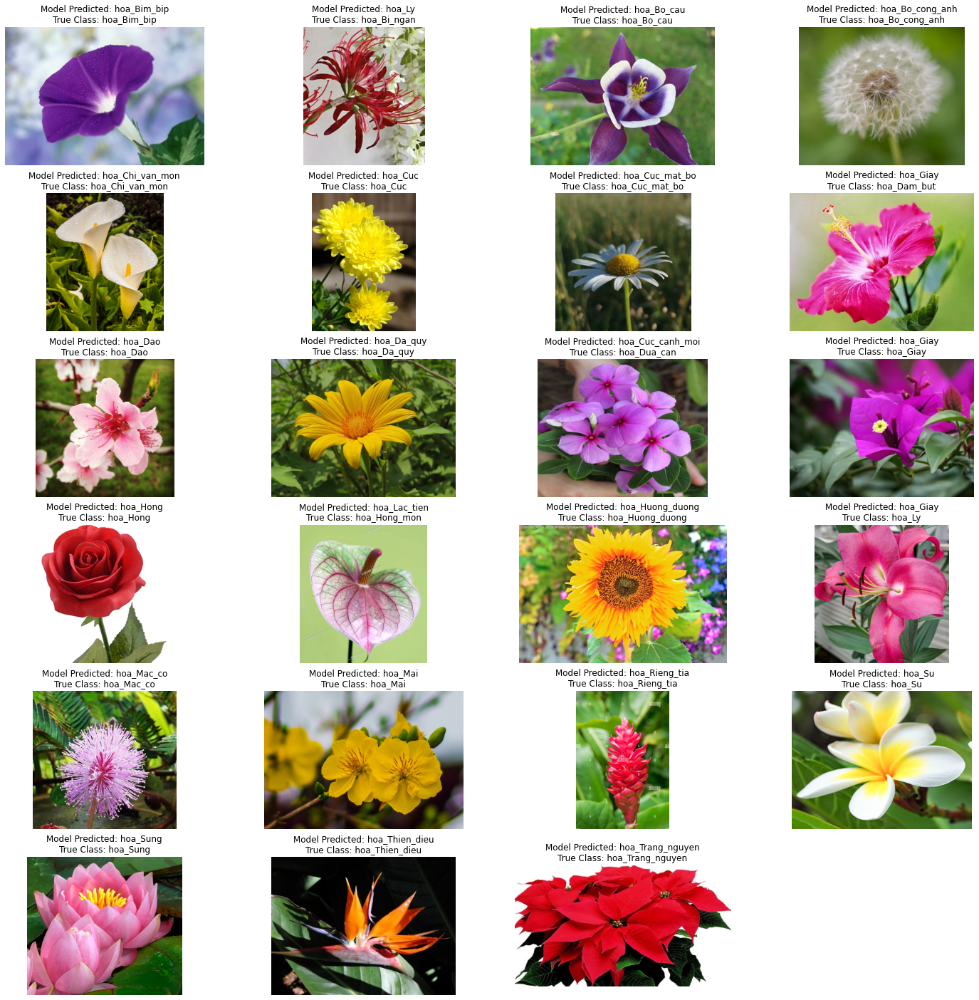

In [99]:
evaluate_model(model_aug)

Accuracy= 100.0%
Số hoa đoán đúng: 23, Số hoa đoán sai: 0


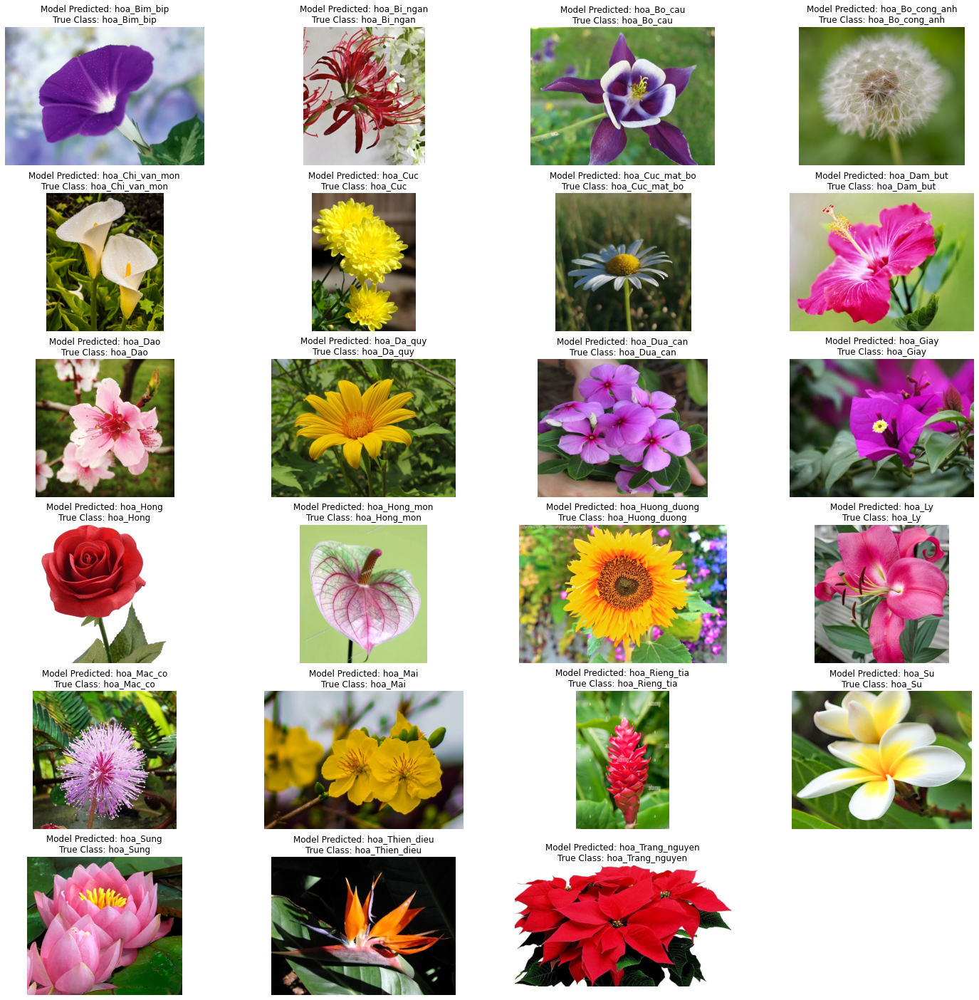

In [100]:
evaluate_model(resnet_model)

Hoa Anh thảo: 5.552875492753628e-06 %
Hoa Anh túc: 3.692453287573727e-08 %
Hoa Bỉ ngạn: 2.9803677303874565e-07 %
Hoa Bìm bịp: 4.089762140058184e-08 %
Hoa Bồ câu: 4.307023626637374e-07 %
Hoa Bồ công anh: 6.421196729888834e-06 %
Hoa Bướm: 2.410687471865458e-06 %
Hoa Cẩm chướng: 4.729022506921865e-07 %
hoa Cẩm tú cầu: 2.5194983252485592e-09 %
Hoa Chi vân môn: 5.886721232001291e-11 %
Hoa Cúc: 0.0033255957532674074 %
Hoa Cúc cánh mối: 0.00918173900572583 %
Hoa Cúc gai tím: 0.002520837733754888 %
Hoa Cúc mắt bò: 99.9808132648468 %
Hoa Dã quỳ: 0.00015800405890331604 %
Hoa Dâm bụt: 0.0004568385520542506 %
Hoa Đào: 1.3570168988508158e-06 %
Hoa Diên vĩ: 1.177682344005726e-09 %
Hoa Dừa cạn: 4.6273740395008645e-08 %
Hoa Giấy: 1.3342853731612703e-09 %
Hoa Hồng: 3.2123859128319054e-09 %
Hoa Hồng bụt: 1.1502720553835388e-05 %
Hoa Hồng môn: 6.633130676669818e-10 %
Hoa Hồng sa mạc: 5.304467975975058e-09 %
Hoa Huệ chuối: 7.103441099221008e-10 %
Hoa Hướng dương: 3.372109702581838e-06 %
Hoa Kế sữa: 7.8047

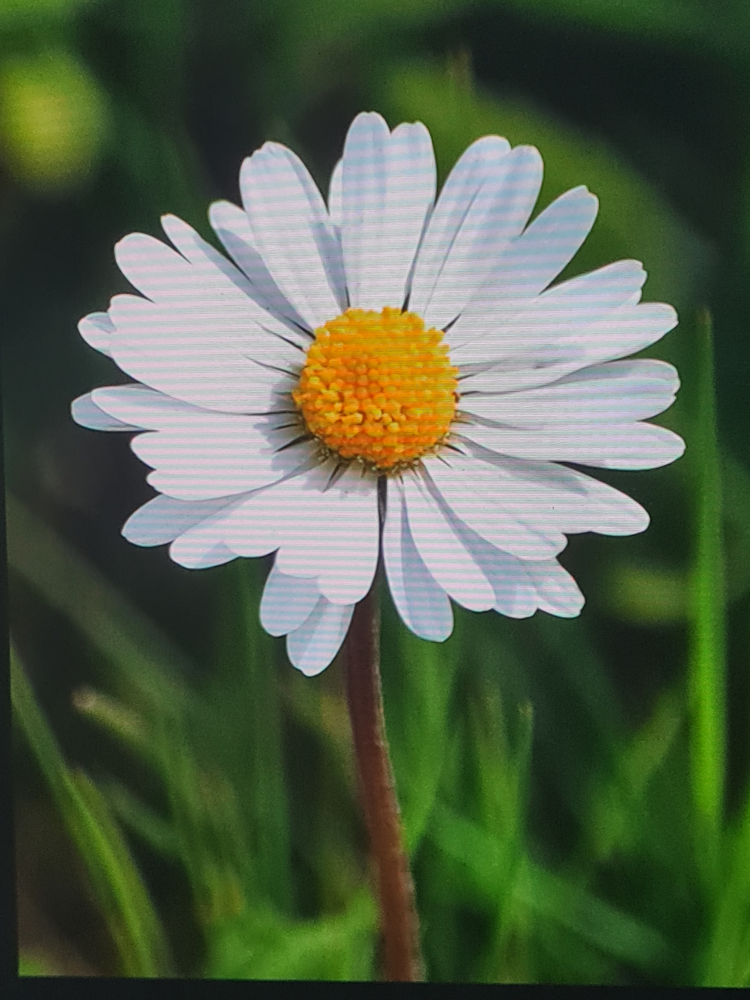

In [106]:
import cv2
import random

def  predict_one_img(img):
    predict_img= img
    
    image=cv2.imread(str(predict_img))[...,::-1]
    image_resized= cv2.resize(image, (256, 256))
    image=np.expand_dims(image_resized,axis=0)
    pred=resnet_model.predict(image)
    for i in range(num_classes):
        print(class_names[i] + ": "+ str(pred[0][i]*100) +" %")
    print()
    output_class=class_names[np.argmax(pred)]
    
    return "Model Predicted: " + output_class

path_dir = "test_data/hoa_Cuc_mat_bo (3).jpg"

print(predict_one_img(path_dir))
PIL.Image.open(path_dir)

In [13]:
images = []
path=[]
for img_path in glob.glob('test_data/*'):
    images.append(mpimg.imread(img_path))
    path.append(img_path)

def  predict_lots_img(img):
        predict_img= img
    
        image=cv2.imread(str(predict_img))[...,::-1]
        image_resized= cv2.resize(image, (256, 256))
        image=np.expand_dims(image_resized,axis=0)
        pred=resnet_model.predict(image)
        output_class= default_classnames[np.argmax(pred)]
    
        return output_class


Số hoa đoán đúng: 17 Tổng số hoa: 17
Accuracy= 100.0%


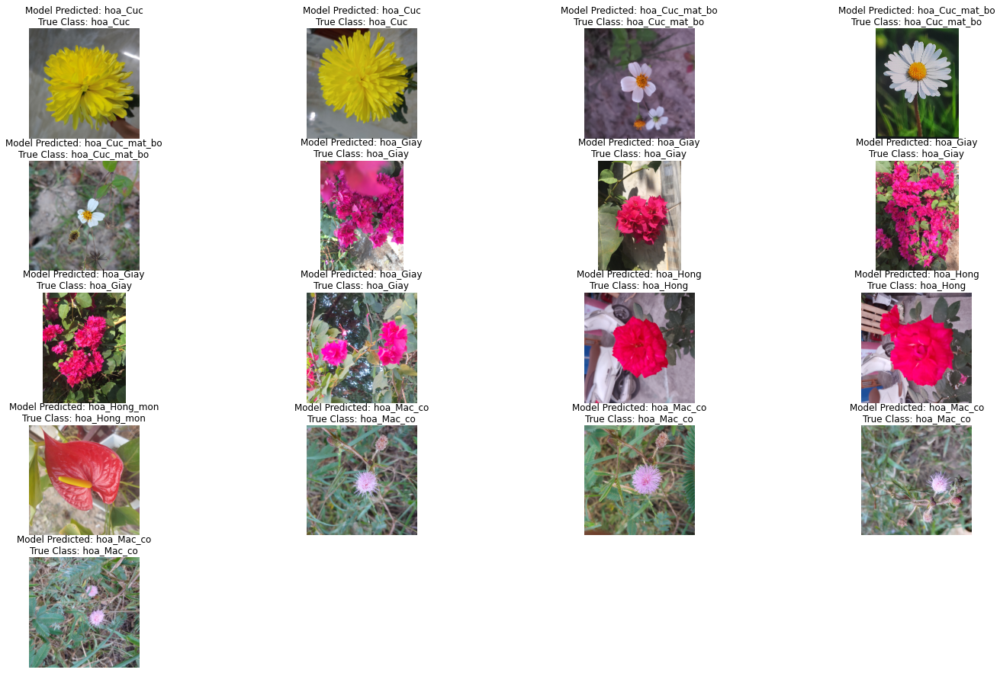

In [14]:

plt.figure(figsize=(25, 25))

count=0
all=0
for i, image in enumerate(images):
    predict_class= predict_lots_img(path[i])
    path_class = path[i].replace("test_data\\","")
    path_class = path_class.replace(".jpg","")
    path_class = re.sub("\(\d\)","", path_class)
    path_class = re.sub(" ","", path_class)
    plt.subplot(8, 4, i+1)
    plt.imshow(image)
    
    plt.title("Model Predicted: "+ predict_class +"\n" + "True Class: " + path_class )
    plt.axis("off")
    if predict_class == path_class:
        count+=1
    all+=1
print("Số hoa đoán đúng: " +str(count) + " Tổng số hoa: " + str(all))
print("Accuracy= " + str(count/all*100) +"%")


In [110]:
import cv2
import random

def  predict_one_img(img):
    predict_img= img
    
    image=cv2.imread(str(predict_img))[...,::-1]
    image_resized= cv2.resize(image, (256, 256))
    image=np.expand_dims(image_resized,axis=0)
    pred=resnet_model.predict(image)

    output_class=default_classnames[np.argmax(pred)]
    
    return output_class



default_path="hoa_Hong"
data_test_dir = pathlib.Path("data/" + default_path)

count=0
all=0
for item in data_test_dir.iterdir():
    print(str(item)+ " :", end=" ")
    print(predict_one_img(item))
    if predict_one_img(item)== default_path:
        count+=1
    all+=1
print("Số lượng đúng: "+ str(count) + " ; " + "Tổng: " + str(all) )
print("Accuracy: " + str(count/all*100) )

data\hoa_Hong\image (1).jpg : hoa_Hong
data\hoa_Hong\image (1).png : hoa_Hong
data\hoa_Hong\image (10).jpg : hoa_Trang_nguyen
data\hoa_Hong\image (10).png : hoa_Hong
data\hoa_Hong\image (100).png : hoa_Hong
data\hoa_Hong\image (101).png : hoa_Hong
data\hoa_Hong\image (102).png : hoa_Hong
data\hoa_Hong\image (103).png : hoa_Hong
data\hoa_Hong\image (104).png : hoa_Hong
data\hoa_Hong\image (105).png : hoa_Hong
data\hoa_Hong\image (106).png : hoa_Hong
data\hoa_Hong\image (107).png : hoa_Hong
data\hoa_Hong\image (108).png : hoa_Hong
data\hoa_Hong\image (109).png : hoa_Hong
data\hoa_Hong\image (11).jpg : hoa_Trang_nguyen
data\hoa_Hong\image (11).png : hoa_Trang_nguyen
data\hoa_Hong\image (110).png : hoa_Hong
data\hoa_Hong\image (111).png : hoa_Hong
data\hoa_Hong\image (112).png : hoa_Hong
data\hoa_Hong\image (113).png : hoa_Hong
data\hoa_Hong\image (114).png : hoa_Hong
data\hoa_Hong\image (115).png : hoa_Hong
data\hoa_Hong\image (116).png : hoa_Hong
data\hoa_Hong\image (117).png : hoa_Hong


In [51]:
x_val=[]
y_val=[]
for images, labels in val_ds.take(-1):  # only take first element of dataset
    for item in labels.numpy():
        y_val.append(item)
    for item in images.numpy():
        x_val.append(item)
 

In [52]:
y_val= np.array(y_val)
x_val= np.array(x_val)

In [53]:
x_val.shape

(1233, 256, 256, 3)

In [54]:
y_val.shape

(1233,)

In [55]:
y_val

array([42, 22,  1, ..., 35, 37, 16])

In [56]:
arr_y_pred= resnet_model.predict(x_val)
y_val_pred=np.argmax(arr_y_pred,axis=1)

In [57]:
y_val_pred

array([31, 22,  1, ..., 35, 37, 16], dtype=int64)

In [58]:
from sklearn.metrics import accuracy_score

In [59]:
accuracy_score( y_val , y_val_pred)

0.9294403892944039

In [ ]:
!pip install mlxtend

In [60]:
from mlxtend.plotting import plot_confusion_matrix
from sklearn.metrics import confusion_matrix

In [61]:
mat= confusion_matrix( y_val , y_val_pred)

(<Figure size 2160x2160 with 1 Axes>,
 <AxesSubplot:xlabel='predicted label', ylabel='true label'>)

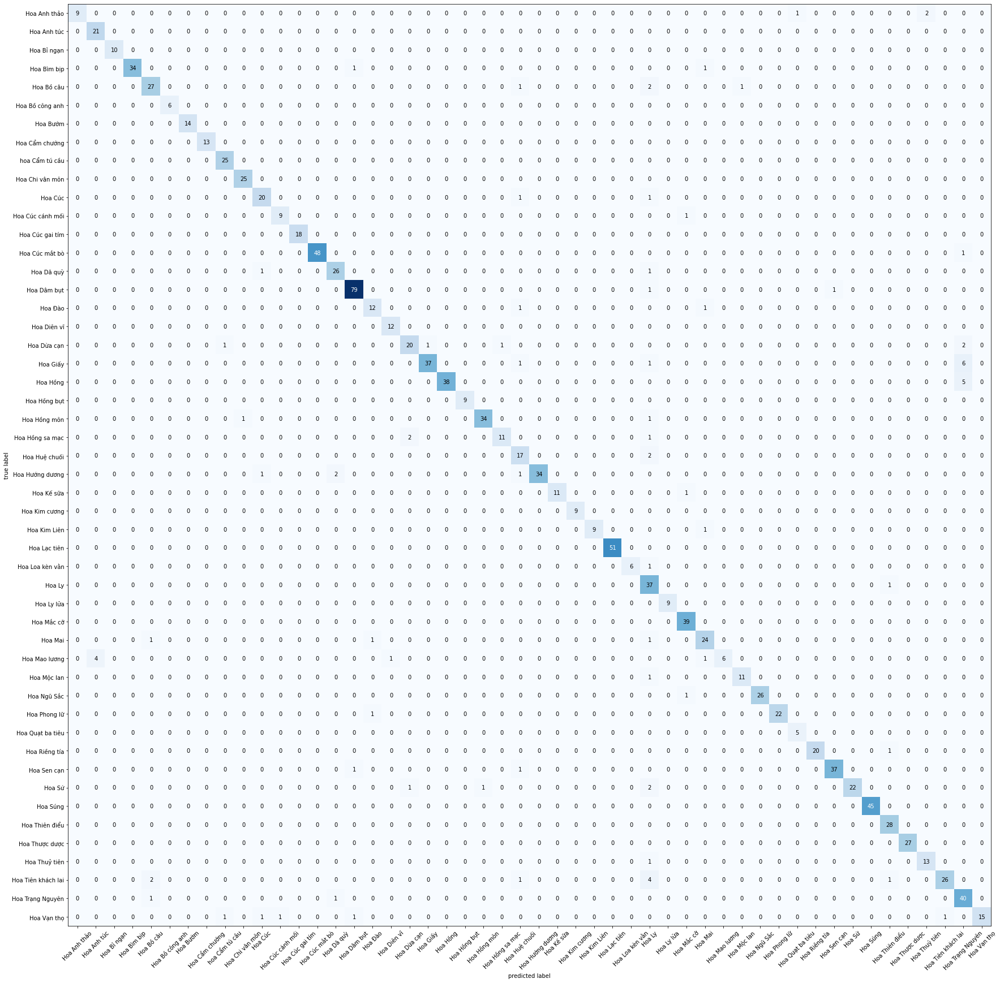

In [71]:
plot_confusion_matrix(conf_mat=mat , figsize=(30,30), class_names= class_names )

(<Figure size 2160x2160 with 1 Axes>,
 <AxesSubplot:xlabel='predicted label', ylabel='true label'>)

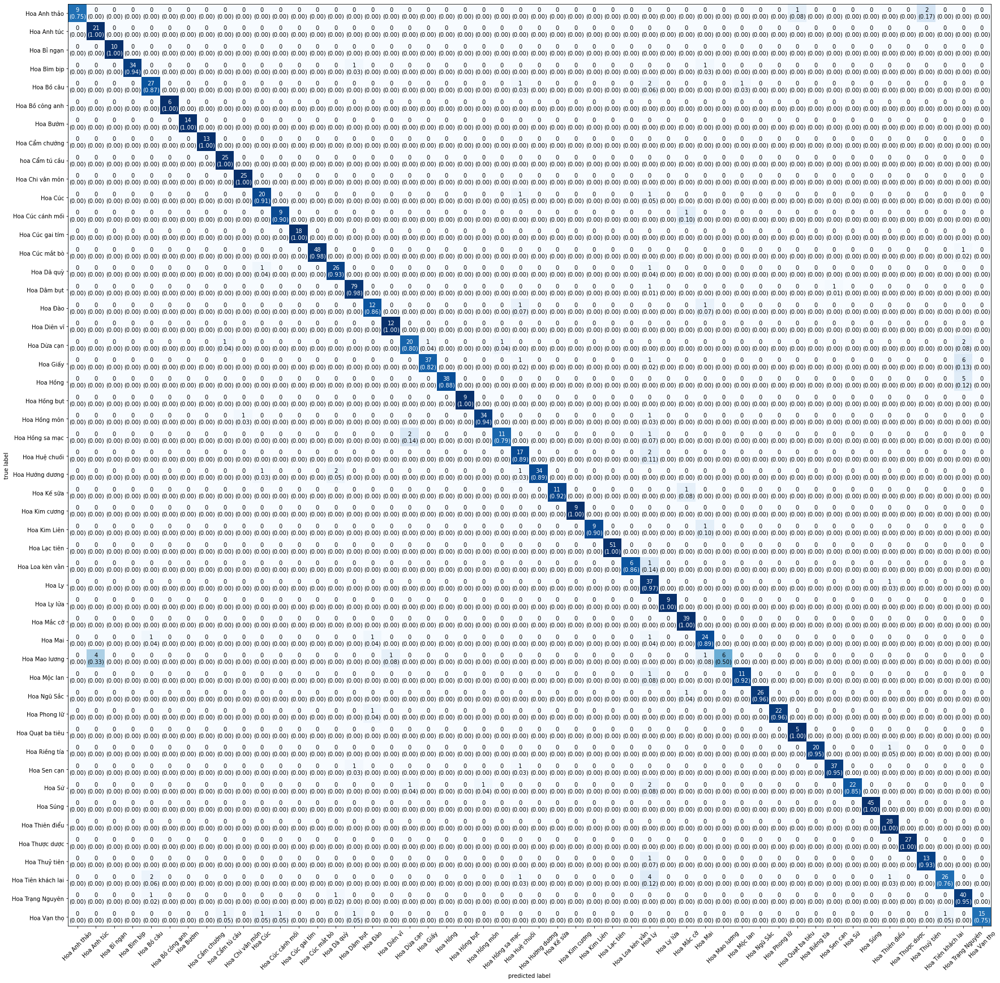

In [66]:
plot_confusion_matrix(conf_mat=mat , figsize=(30,30), class_names= class_names, show_normed= True )

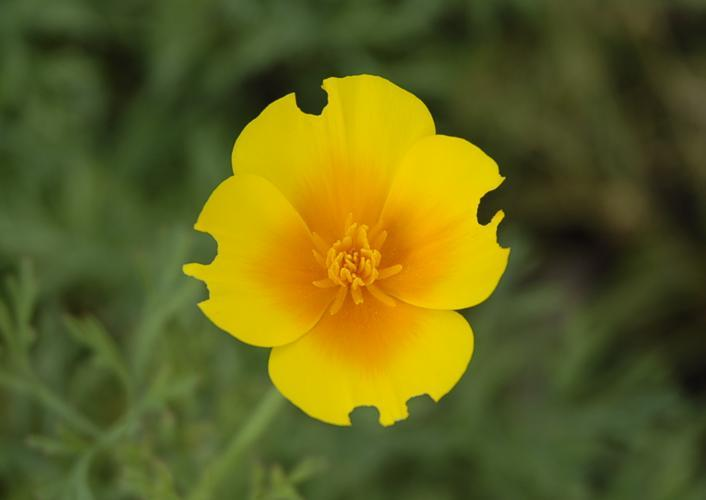

In [70]:
PIL.Image.open("data\hoa_Anh_tuc\image_03182.jpg")


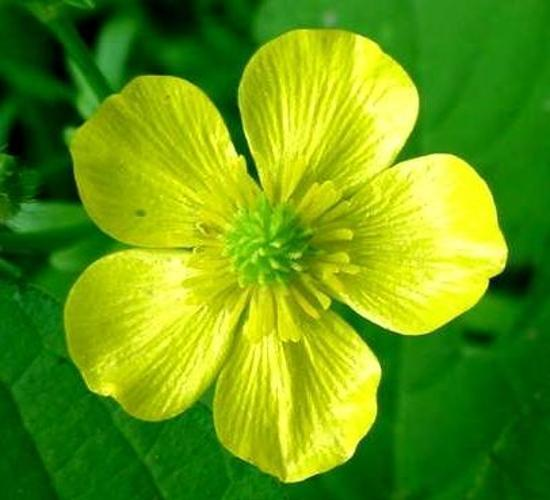

In [69]:
PIL.Image.open("data\hoa_Mao_luong\image_04675.jpg")